In [1]:
%cd ..
%ls

/home/nas3_userJ/dmkim/OnlineTSAD
cfgs/         data/  Exp/     logs/    outputs/  results/  train.py*  Vis/
checkpoints/  EDA/   hptune/  models/  plots/    test.py*  utils/     wandb/


In [2]:
import torch
from torch import optim
import torch.nn.functional as F

import matplotlib.pyplot as plt

from utils.metrics import get_summary_stats

from models.MLP import MLP

import wandb
import hydra
from omegaconf import DictConfig

from utils.logger import make_logger
from utils.argpass import prepare_arguments, configure_exp_id
from utils.tools import SEED_everything, plot_interval

import warnings
from data.load_data import DataFactory
from Exp.ReconBaselines import *

from easydict import EasyDict as edict
import yaml
import re
import copy

warnings.filterwarnings("ignore")

In [3]:
# load yaml
cfg = {}
loader = yaml.SafeLoader
loader.add_implicit_resolver(
    u'tag:yaml.org,2002:float',
    re.compile(u'''^(?:
     [-+]?(?:[0-9][0-9_]*)\\.[0-9_]*(?:[eE][-+]?[0-9]+)?
    |[-+]?(?:[0-9][0-9_]*)(?:[eE][-+]?[0-9]+)
    |\\.[0-9_]+(?:[eE][-+][0-9]+)?
    |[-+]?[0-9][0-9_]*(?::[0-5]?[0-9])+\\.[0-9_]*
    |[-+]?\\.(?:inf|Inf|INF)
    |\\.(?:nan|NaN|NAN))$''', re.X),
    list(u'-+0123456789.'))

# get cfg
model = "MLP"
with open("cfgs/test_defaults.yaml", "r") as file:
    basic_config = yaml.load(file, Loader=loader)
    cfg.update(basic_config)
with open(f"cfgs/model/{model}.yaml", "r") as file:
    model_config = yaml.load(file, Loader=loader)
    cfg.update({"model": model_config})
cfg['dataset'] = 'WADI'
cfg["use_RevIN"] = True

In [4]:
args = prepare_arguments(cfg)
args.model.latent_dim = 128
args.window_size = 12
args.eval_batch_size = 1
args.dataset = "WADI"
print(args)

logger = make_logger(os.path.join(args.log_path, f'{args.exp_id}.log'))
logger.info(f"Configurations: {args}")

# Data
logger.info(f"Preparing {args.dataset} dataset...")
datafactory = DataFactory(args, logger)
train_dataset, train_loader, test_dataset, test_loader = datafactory()
args.num_channels = train_dataset.X.shape[1]
train_X, train_y, test_X, test_y = train_dataset.X, train_dataset.y, test_dataset.X, test_dataset.y

print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

[2023-04-10 15:51:08,760] Configurations: {'exp_id': 'MLP_WADI_RevIN_True', 'infer_options': ['offline', 'online_us_bce_seq'], 'dataset': 'WADI', 'batch_size': 64, 'eval_batch_size': 1, 'window_size': 12, 'stride': 1, 'eval_stride': 12, 'scaler': 'std', 'load_previous_error': True, 'lr': 0.001, 'epochs': 30, 'TT_loss': 'bce', 'cls_lambda': 1, 'ttlr': 0.001, 'thlr': 0.001, 'use_RevIN': True, 'log_freq': 10, 'checkpoint_path': './checkpoints/MLP_WADI_RevIN_True', 'log_path': './logs/MLP_WADI_RevIN_True', 'output_path': './outputs/MLP_WADI_RevIN_True', 'plot_path': './plots/MLP_WADI_RevIN_True', 'result_path': './results/MLP_WADI_RevIN_True', 'plot_anomaly_scores': True, 'plot_recon_status': False, 'defaults': [{'model': 'MLP'}], 'model': {'name': 'MLP', 'latent_dim': 128}, 'home_dir': '.', 'device': device(type='cuda')}
[2023-04-10 15:51:08,761] Preparing WADI dataset...
[2023-04-10 15:51:08,762] current location: /home/nas3_userJ/dmkim/OnlineTSAD
[2023-04-10 15:51:08,763] Preparing WADI

{'exp_id': 'MLP_WADI_RevIN_True', 'infer_options': ['offline', 'online_us_bce_seq'], 'dataset': 'WADI', 'batch_size': 64, 'eval_batch_size': 1, 'window_size': 12, 'stride': 1, 'eval_stride': 12, 'scaler': 'std', 'load_previous_error': True, 'lr': 0.001, 'epochs': 30, 'TT_loss': 'bce', 'cls_lambda': 1, 'ttlr': 0.001, 'thlr': 0.001, 'use_RevIN': True, 'log_freq': 10, 'checkpoint_path': './checkpoints/MLP_WADI_RevIN_True', 'log_path': './logs/MLP_WADI_RevIN_True', 'output_path': './outputs/MLP_WADI_RevIN_True', 'plot_path': './plots/MLP_WADI_RevIN_True', 'result_path': './results/MLP_WADI_RevIN_True', 'plot_anomaly_scores': True, 'plot_recon_status': False, 'defaults': [{'model': 'MLP'}], 'model': {'name': 'MLP', 'latent_dim': 128}, 'home_dir': '.', 'device': device(type='cuda')}


[2023-04-10 15:51:42,825] train: X - (784571, 123), y - (784571,) test: X - (172803, 123), y - (172803,)
[2023-04-10 15:51:43,083] Complete.
[2023-04-10 15:51:43,084] Preparing dataloader...
[2023-04-10 15:51:45,535] total train dataset- 12259, batch_X - torch.Size([64, 12, 123]), batch_y - torch.Size([64, 12])
[2023-04-10 15:51:45,537] total test dataset- 14400, batch_X - torch.Size([1, 12, 123]), batch_y - torch.Size([1, 12])
[2023-04-10 15:51:45,538] Complete.


(784571, 123) (784571,) (172800, 123) (172800,)


## Visualize

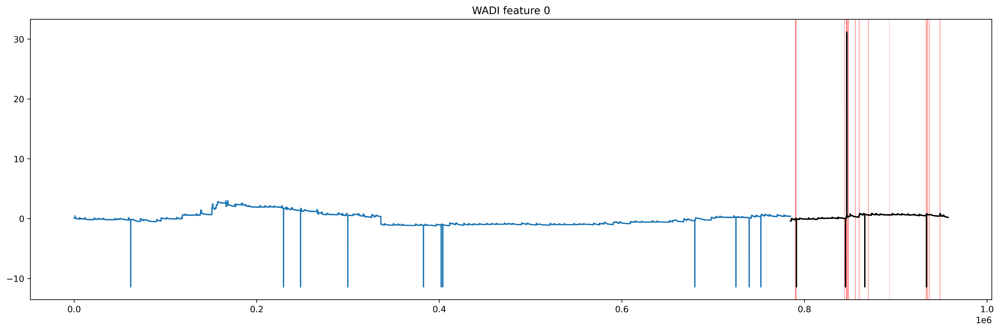

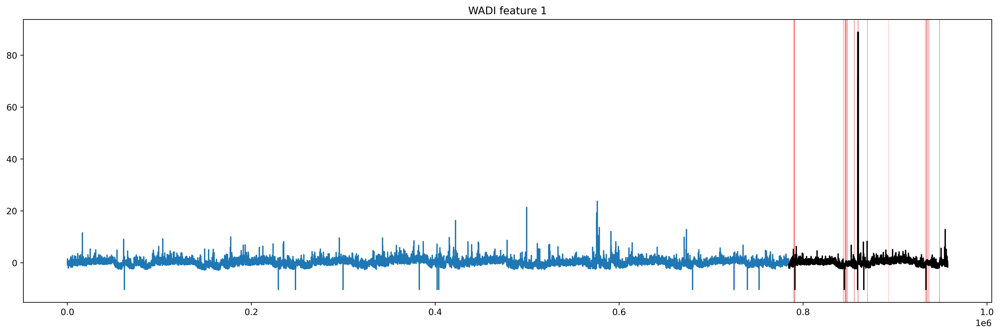

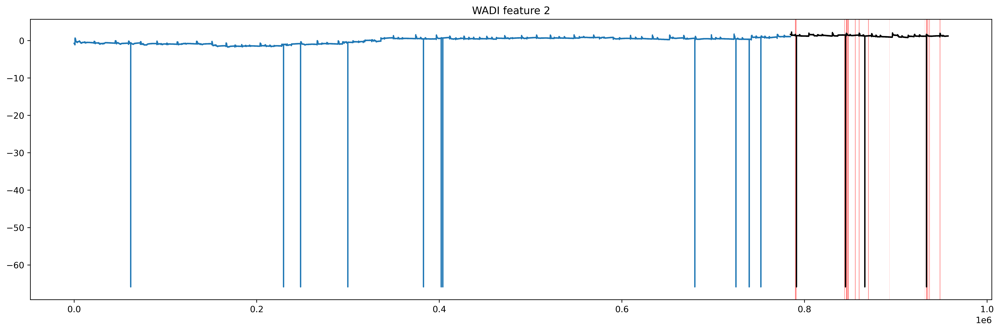

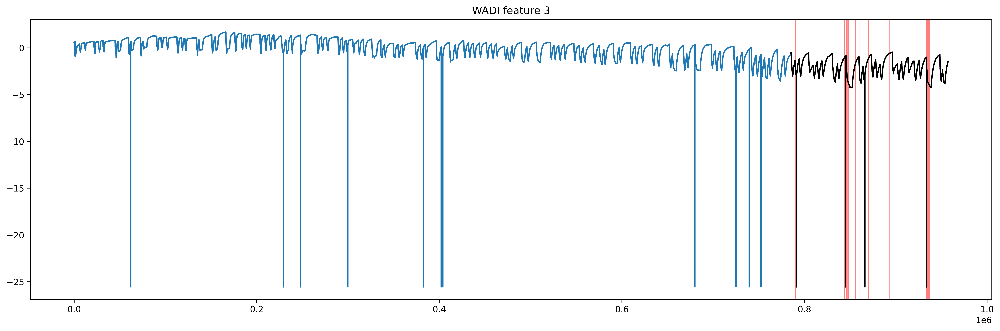

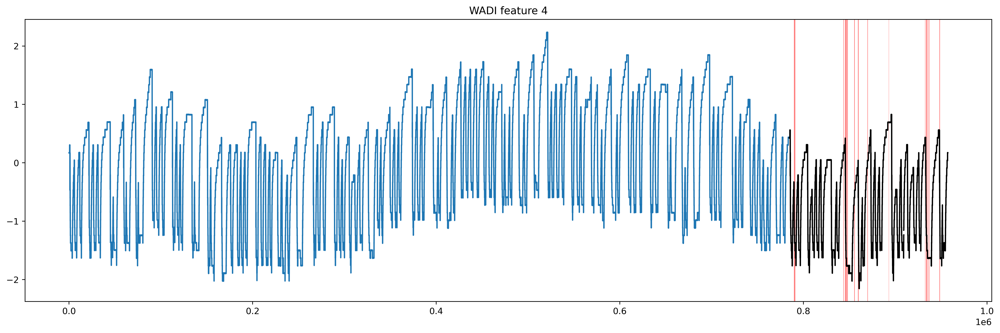

...

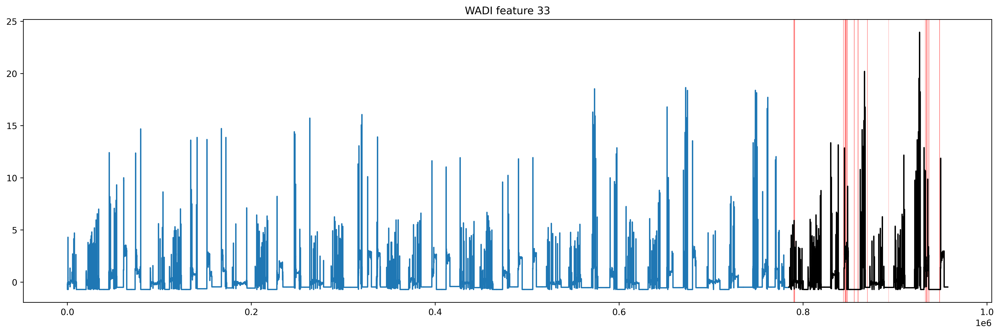

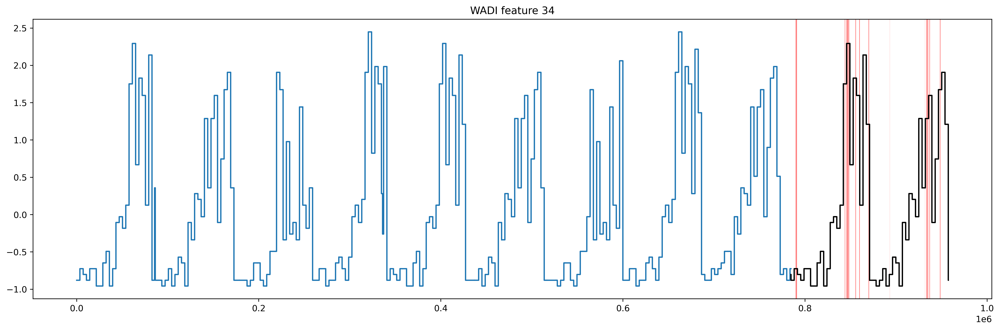

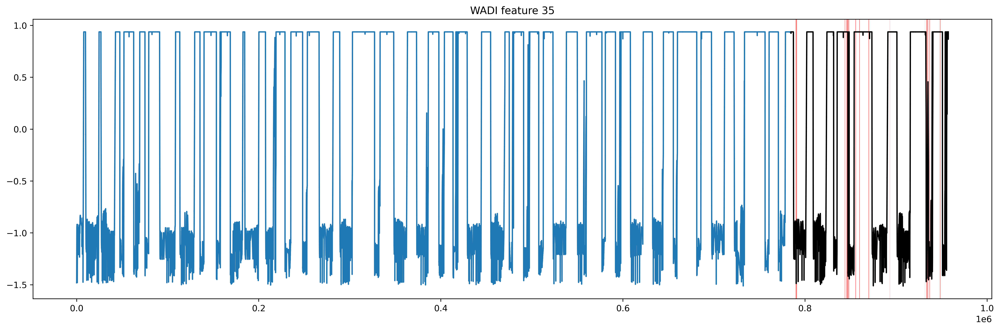

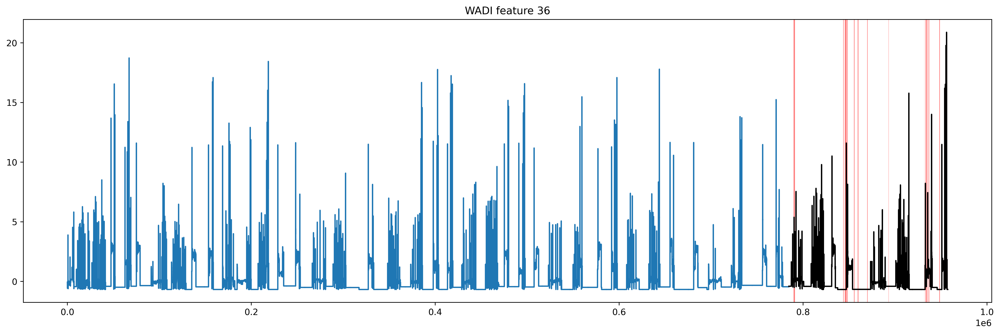

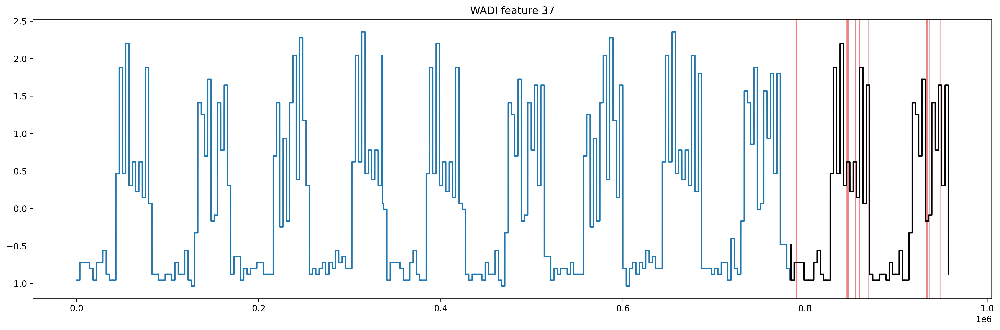

KeyboardInterrupt: 

In [5]:
for c in range(args.num_channels):
    dataset_name = "WADI"
    plt.figure(figsize=(20, 6), dpi=500)
    plt.plot(train_X[:, c], color="C0")
    plt.plot(range(len(train_X), len(train_X)+len(test_X)), test_X[:, c], color="black")
    label = np.concatenate([np.array([0]*len(train_X)), test_y])
    plot_interval(plt, label)
    plt.title(f"{dataset_name} feature {c}")
    plt.show()

## Load Model

In [5]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_WADI_RevIN_True", f"best.pth"))

[2023-04-10 15:51:50,591] loading: ./checkpoints/MLP_WADI_RevIN_True/best.pth @Trainer - torch.load_state_dict
[2023-04-10 15:51:50,610] train_errors.pt file does not exist, calculating...
calculating reconstruction errors: 100%|██████████| 12259/12259 [01:03<00:00, 192.47it/s]
[2023-04-10 15:52:54,371] saving train_errors.pt...
[2023-04-10 15:52:57,561] test_errors.pt file does not exist, calculating...
calculating reconstruction errors: 100%|██████████| 14400/14400 [00:18<00:00, 798.00it/s]
[2023-04-10 15:53:15,679] saving test_errors.pt...
[2023-04-10 15:53:16,224] Best threshold found at: 5.08422999700997e-05, with fpr: 0.9972239794132278, tpr: 0.9985967725769269
tn: 452 fn: 14
fp: 162371 tp: 9963
[2023-04-10 15:53:16,226] loading: ./checkpoints/MLP_WADI_RevIN_True/best.pth @Trainer - torch.load_state_dict


In [6]:
next(iter(tester.model.parameters())).device, next(iter(tester.model.parameters())).requires_grad

(device(type='cuda', index=0), True)

## Training statistics

In [7]:
train_iterator = tqdm(
    tester.train_loader,
    total=len(tester.train_loader),
    desc="calculating reconstruction errors",
    leave=True
)

recon_errors = []
with torch.no_grad():
    for i, batch_data in enumerate(train_iterator):
        X = batch_data[0].to(args.device)
        B, L, C = X.shape
        Xhat = tester.model(X)
        recon_error = torch.nn.functional.mse_loss(Xhat, X, reduction='none')
        recon_errors.append(recon_error)

recon_errors = torch.cat(recon_errors, axis=0)

train_error_dist = recon_errors.mean(dim=(1, 2))

print(f"{recon_errors.shape}, {train_error_dist.shape}")

calculating reconstruction errors: 100%|██████████| 12259/12259 [01:02<00:00, 196.20it/s]


torch.Size([784560, 12, 123]), torch.Size([784560])


In [8]:
torch.cuda.empty_cache()

## Test: static threshold inference

In [9]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

anoscs_prev = []
Xhats_prev = []
with torch.no_grad():
    for i, batch_data in enumerate(eval_iterator):
        X, y = batch_data[0].to(args.device), batch_data[1].to(args.device)
        B, L, C = X.shape
        Xhat = tester.model(X)
        Xhats_prev.append(Xhat)        
        e = F.mse_loss(Xhat, X, reduction='none')
        anosc = e.mean(dim=2)
        anoscs_prev.append(anosc)

Xhats_prev = torch.cat(Xhats_prev, axis=0).detach().cpu().numpy()
anoscs_prev = torch.cat(anoscs_prev, axis=0).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 14400/14400 [00:20<00:00, 712.23it/s]


In [10]:
torch.cuda.empty_cache()

In [11]:
th_q95 = torch.quantile(train_error_dist, 0.95).item()
th_q99 = torch.quantile(train_error_dist, 0.99).item()
th_q100 = torch.max(train_error_dist).item()
th_best_static = tester.get_best_static_threshold(gt=test_y, anomaly_scores=anoscs_prev)
th_q95, th_q99, th_q100, th_best_static

[2023-04-10 15:55:10,682] Best threshold found at: 5.084229269414209e-05, with fpr: 0.9972239794132278, tpr: 0.9985967725769269
tn: 452 fn: 14
fp: 162371 tp: 9963


(0.02068766951560974, 0.0890066996216774, 81.8661117553711, 5.0842293e-05)

In [12]:
# 95
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q95))
# 99
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q99))
# 100
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q100))
# oracle
print(get_summary_stats(test_dataset.y, anoscs_prev > th_best_static))

{'Accuracy': 0.6166145833333333, 'Precision': 0.051145427860379046, 'Recall': 0.32133907988373256, 'F1': 0.08824541363317322, 'tn': 103345, 'fp': 59478, 'fn': 6771, 'tp': 3206}
{'Accuracy': 0.7450925925925926, 'Precision': 0.05337807723566578, 'Recall': 0.2040693595269119, 'F1': 0.08462177888611803, 'tn': 126716, 'fp': 36107, 'fn': 7941, 'tp': 2036}
{'Accuracy': 0.9388946759259259, 'Precision': 0.08781869688385269, 'Recall': 0.006214292873609302, 'F1': 0.011607226434522139, 'tn': 162179, 'fp': 644, 'fn': 9915, 'tp': 62}
{'Accuracy': 0.060266203703703704, 'Precision': 0.057806688214097124, 'Recall': 0.9984965420467075, 'F1': 0.1092863803411771, 'tn': 452, 'fp': 162371, 'fn': 15, 'tp': 9962}


In [14]:
tester.model

MLP(
  (encoder): Encoder(
    (linear1): Linear(in_features=1476, out_features=738, bias=True)
    (relu1): ReLU()
    (linear2): Linear(in_features=738, out_features=369, bias=True)
    (relu2): ReLU()
    (linear3): Linear(in_features=369, out_features=128, bias=True)
    (relu3): ReLU()
  )
  (decoder): Decoder(
    (linear1): Linear(in_features=128, out_features=369, bias=True)
    (relu1): ReLU()
    (linear2): Linear(in_features=369, out_features=738, bias=True)
    (relu2): ReLU()
    (linear3): Linear(in_features=738, out_features=1476, bias=True)
  )
  (revin): RevIN()
)

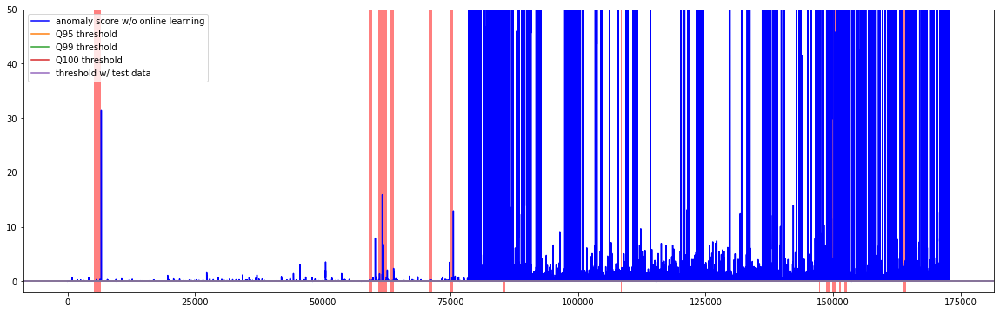

In [19]:
plt.figure(figsize=(20, 6))
plt.ylim([-2, 50])
plt.plot(anoscs_prev, color="blue", label="anomaly score w/o online learning")
#plt.plot(anoscs, color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="C1", label="Q95 threshold")
plt.axhline(th_q99, color="C2", label="Q99 threshold")
plt.axhline(th_q100, color="C3", label="Q100 threshold")
plt.axhline(th_best_static, color="C4", label="threshold w/ test data")

#plt.plot(thrs, color="gold",label="dynamic threshold")
plt.legend()
plot_interval(plt, test_y)
plt.show()

In [16]:
tester.model

MLP(
  (encoder): Encoder(
    (linear1): Linear(in_features=612, out_features=306, bias=True)
    (relu1): ReLU()
    (linear2): Linear(in_features=306, out_features=153, bias=True)
    (relu2): ReLU()
    (linear3): Linear(in_features=153, out_features=128, bias=True)
    (relu3): ReLU()
  )
  (decoder): Decoder(
    (linear1): Linear(in_features=128, out_features=153, bias=True)
    (relu1): ReLU()
    (linear2): Linear(in_features=153, out_features=306, bias=True)
    (relu2): ReLU()
    (linear3): Linear(in_features=306, out_features=612, bias=True)
  )
)

## Value-based Pseudo-label guided Online Learning (separate threshold)

### 1. Single+CE

In [45]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr = torch.tensor(thr, requires_grad=True)
thr

tensor(0.0207, requires_grad=True)

In [46]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_WADI_RevIN_True", f"best.pth"))

[2023-04-10 16:27:23,787] loading: ./checkpoints/MLP_WADI_RevIN_True/best.pth @Trainer - torch.load_state_dict
[2023-04-10 16:27:24,038] train_errors.pt file exists, loading...
[2023-04-10 16:27:24,084] torch.Size([784560, 12])
[2023-04-10 16:27:24,109] test_errors.pt file exists, loading...
[2023-04-10 16:27:24,113] torch.Size([14400, 12])
[2023-04-10 16:27:24,462] Best threshold found at: 5.08422999700997e-05, with fpr: 0.9972239794132278, tpr: 0.9985967725769269
tn: 452 fn: 14
fp: 162371 tp: 9963
[2023-04-10 16:27:24,464] loading: ./checkpoints/MLP_WADI_RevIN_True/best.pth @Trainer - torch.load_state_dict


In [47]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([p for p in tester.model.parameters()], lr=lr)
TH_optimizer = torch.optim.SGD([thr], lr=1e-05)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr.clone().detach().item())
    
    # learn new-normals
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    recon_loss = (A*mask).mean()
    recon_loss.backward()
    TT_optimizer.step()
    
    # update threshold
    TH_optimizer.zero_grad()
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    yhat = torch.sigmoid((A-thr))
    cls_loss = bce(yhat, ytilde)
    cls_loss.backward()
    TH_optimizer.step()
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 14400/14400 [01:54<00:00, 125.53it/s]


In [48]:
print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

(172800,) (172800,)
{'Accuracy': 0.7015162037037037, 'Precision': 0.05208983828247809, 'Recall': 0.24245765260098226, 'F1': 0.08575581395348837, 'tn': 118803, 'fp': 44020, 'fn': 7558, 'tp': 2419}


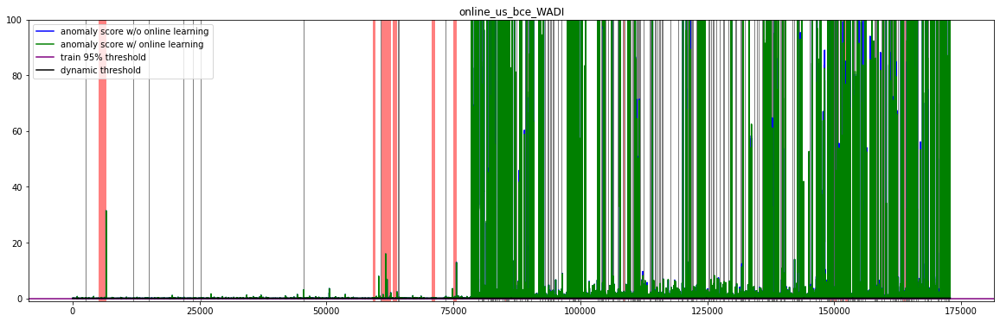

In [51]:
#s, e = 26751, 26851
s, e = 0, -1
plt.figure(figsize=(20, 6))#, dpi=500)
plt.title(f"online_us_bce_{args.dataset}")
plt.ylim([-1, 100])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=1)
plt.legend()
plt.show()

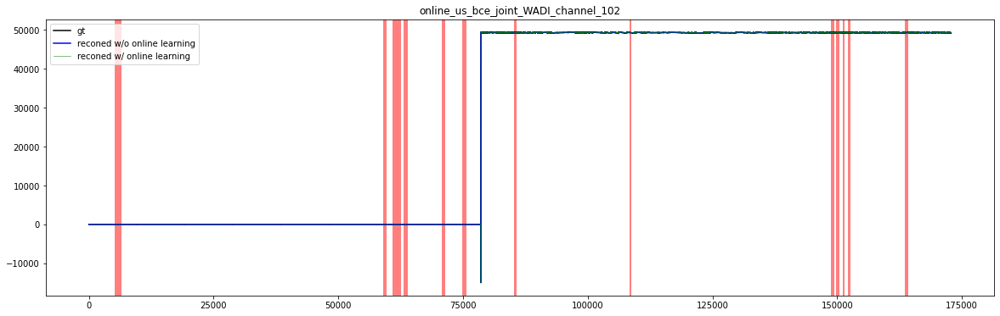

In [50]:
c = 102
test_X, test_y = test_dataset.X, test_dataset.y

B, L, C = Xhats.shape

plt.figure(figsize=(20, 6))#, dpi=500)
plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")
#plt.ylim([49000, 50000])

plt.plot(test_X[:, c], color="black", label="gt")

plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
plt.legend()
plot_interval(plt, test_y)

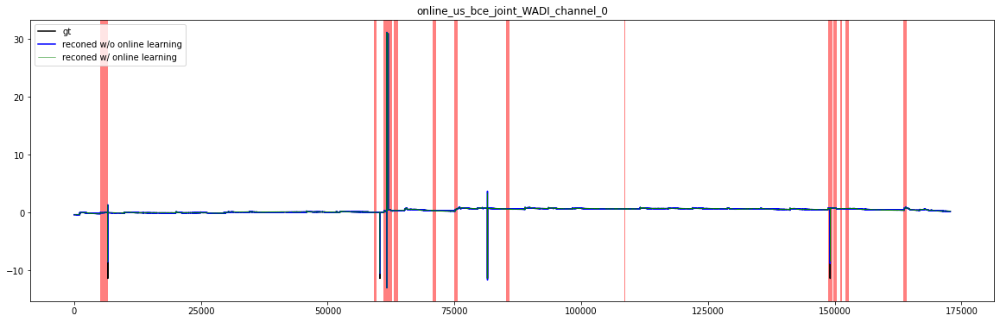

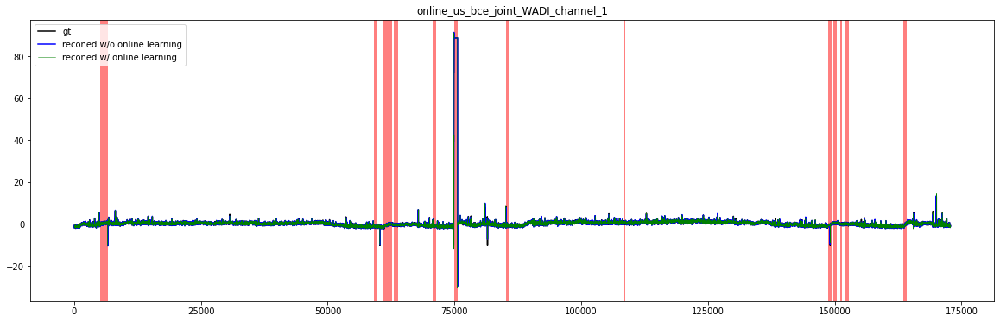

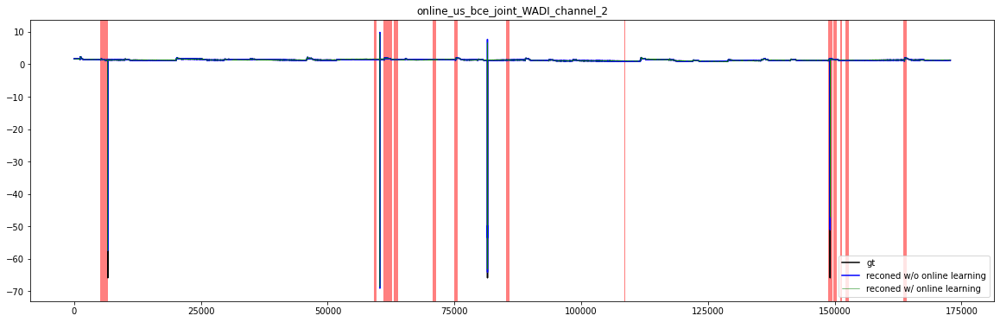

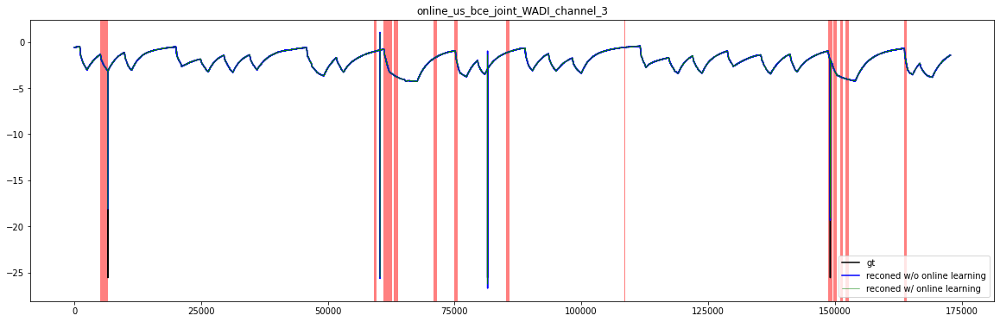

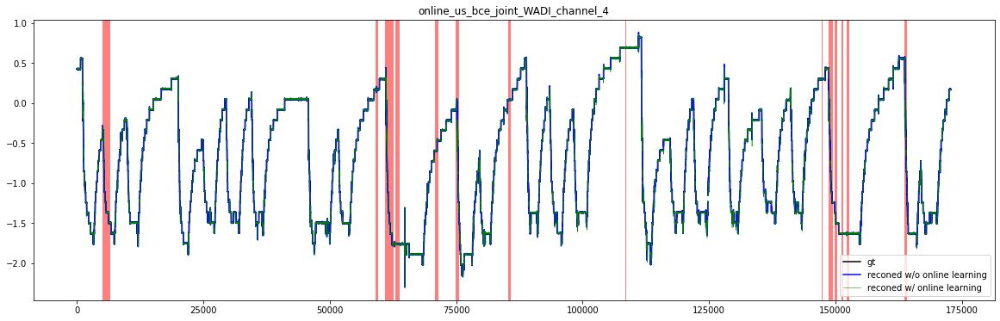

...

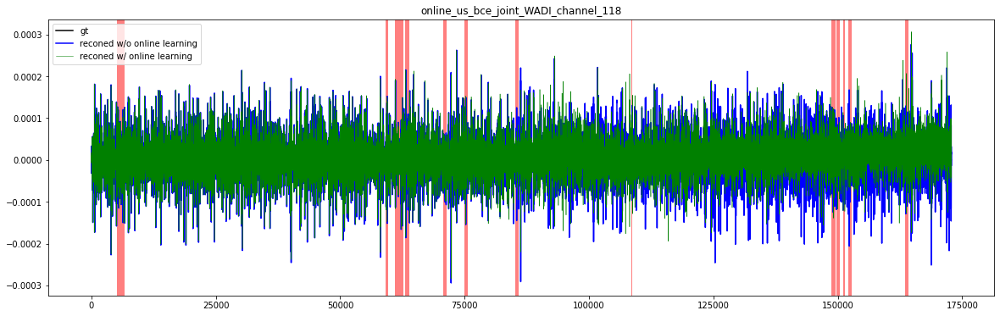

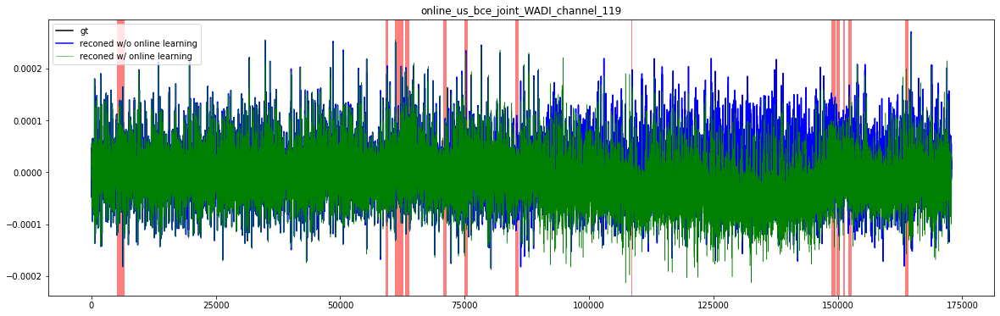

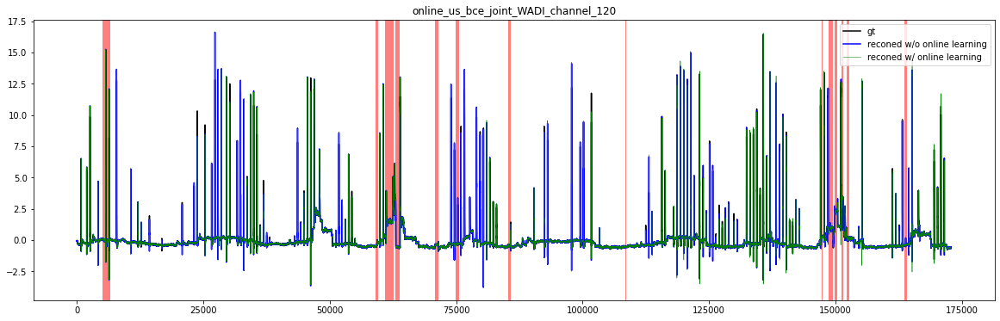

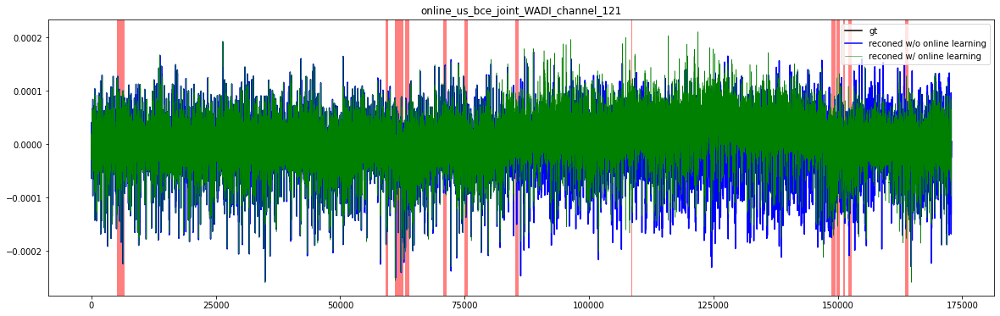

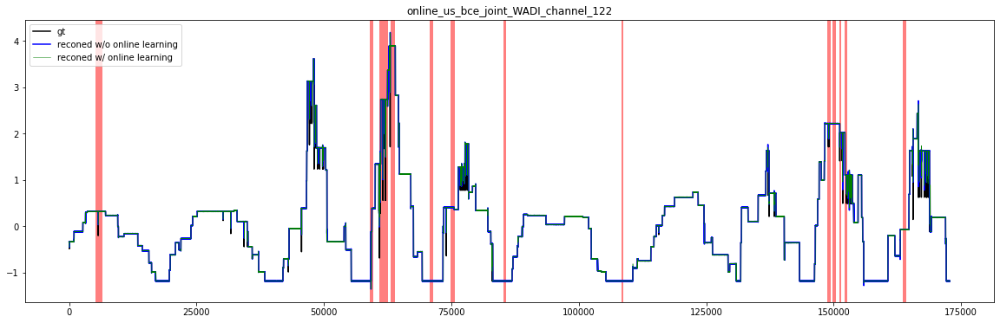

In [44]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6))
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(test_X[:, c], color="black", label="gt")
    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    
    plt.legend()
    plot_interval(plt, test_y)

### Just learn normals

In [22]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr

0.009716848842799664

In [23]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SWaT", f"best.pth"))

[2023-04-08 20:22:09,821] loading: ./checkpoints/MLP_SWaT/best.pth @Trainer - torch.load_state_dict
[2023-04-08 20:22:09,832] train_errors.pt file exists, loading...
[2023-04-08 20:22:09,858] torch.Size([496789, 12])
[2023-04-08 20:22:10,046] loading: ./checkpoints/MLP_SWaT/best.pth @Trainer - torch.load_state_dict


In [25]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([p for p in tester.model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr)
    
    # learn new-normals
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    recon_loss = (A*mask).mean()
    recon_loss.backward()
    TT_optimizer.step()
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 37493/37493 [01:55<00:00, 323.97it/s]


In [26]:
print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

(449916,) (449916,)
{'Accuracy': 0.3220134425092684, 'Precision': 0.1476750630927696, 'Recall': 0.9616004690019053, 'F1': 0.2560309063371161, 'tn': 92391, 'fp': 302941, 'fn': 2096, 'tp': 52488}


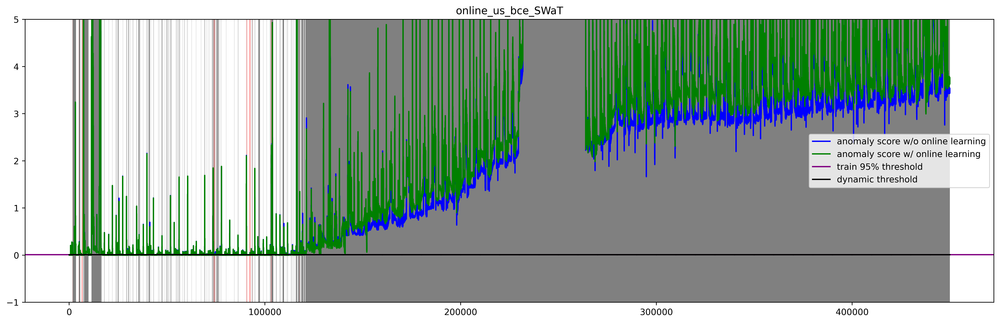

In [27]:
#s, e = 26751, 26851
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_{args.dataset}")
plt.ylim([-1, 5])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=1)
plt.legend()
plt.show()

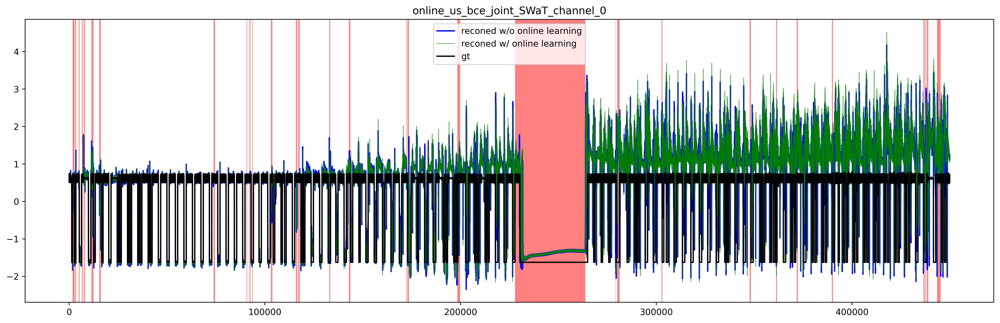

In [28]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    plt.plot(test_X[:, c], color="black", label="gt")
    plt.legend()
    plot_interval(plt, test_y)
    break

### src-tgt network

In [42]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr

0.009716848842799664

In [43]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SWaT", f"best.pth"))


pretrained_model = tester.model
source_model = copy.deepcopy(pretrained_model)
target_model = copy.deepcopy(pretrained_model)
ema_updater = EMAUpdater(source_model, target_model, 0.99)

[2023-04-08 21:07:04,143] loading: ./checkpoints/MLP_SWaT/best.pth @Trainer - torch.load_state_dict
[2023-04-08 21:07:04,153] train_errors.pt file exists, loading...
[2023-04-08 21:07:04,173] torch.Size([496789, 12])
[2023-04-08 21:07:04,359] loading: ./checkpoints/MLP_SWaT/best.pth @Trainer - torch.load_state_dict


In [44]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([p for p in source_model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    with torch.no_grad():
        Xhat_tgt = target_model(X)
        E_tgt = (Xhat_tgt-X)**2
    Xhat_src = source_model(X)
    E_src = (Xhat_src-X)**2
    A = E_src.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat_src.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr)
    
    # learn new-normals
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    
    if i>1000:
        flood_loss = torch.clamp(E_src-E_tgt, min=0).mean()
        flood_loss.backward()
    else:
        recon_loss = (A*mask).mean()
        recon_loss.backward()
    TT_optimizer.step()
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 37493/37493 [02:27<00:00, 254.06it/s]


In [45]:
print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

(449916,) (449916,)
{'Accuracy': 0.29188115114821434, 'Precision': 0.14277789203641364, 'Recall': 0.9666019346328595, 'F1': 0.24880457233398412, 'tn': 78561, 'fp': 316771, 'fn': 1823, 'tp': 52761}


In [ ]:
#s, e = 26751, 26851
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_{args.dataset}")
plt.ylim([-1, 5])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=1)
plt.legend()
plt.show()

### Single + BCE + Label

In [58]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr = torch.tensor(thr, requires_grad=True)
thr

tensor(0.0686, requires_grad=True)

In [59]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_PSM", f"best.pth"))

[2023-04-01 15:50:11,330] loading: ./checkpoints/MLP_PSM/best.pth @Trainer - torch.load_state_dict
[2023-04-01 15:50:11,338] train_errors.pt file exists, loading...
[2023-04-01 15:50:11,346] torch.Size([132470, 12])
[2023-04-01 15:50:11,397] loading: ./checkpoints/MLP_PSM/best.pth @Trainer - torch.load_state_dict


In [60]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([thr]+[p for p in tester.model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr.clone().detach().item())
    
    # learn new-normals and update threshold
    TT_optimizer.zero_grad()
    mask = (y == 0)
    yhat = torch.sigmoid((A - thr))
    cls_loss = bce(yhat, y.float())
    recon_loss = (A * mask).mean()
    loss = recon_loss + cls_loss
    loss.backward()
    TT_optimizer.step()
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 7320/7320 [00:25<00:00, 288.50it/s]


In [61]:
# result summary
print(test_y.shape, preds.shape)
result = get_summary_stats(test_y, preds)
print(result)

(87840,) (87840,)
{'Accuracy': 0.9368055555555556, 'Precision': 0.9889893009244832, 'Recall': 0.7810180058242073, 'F1': 0.8727856078835797, 'tn': 63247, 'fp': 212, 'fn': 5339, 'tp': 19042}


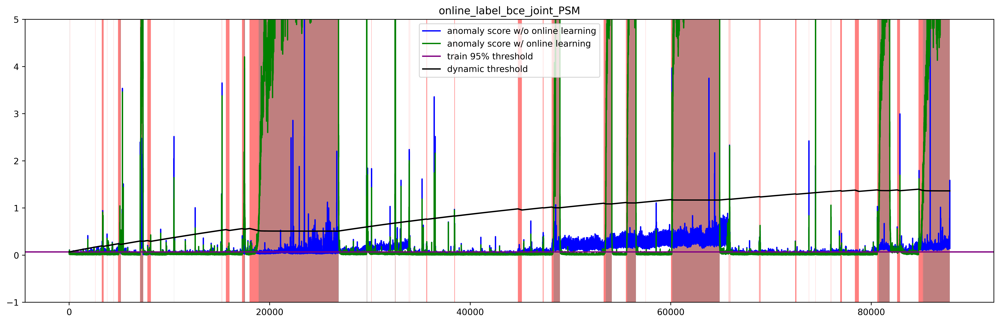

In [62]:
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_label_bce_joint_{args.dataset}")
plt.ylim([-1, 5])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=0.5)
plt.legend()
plt.show()

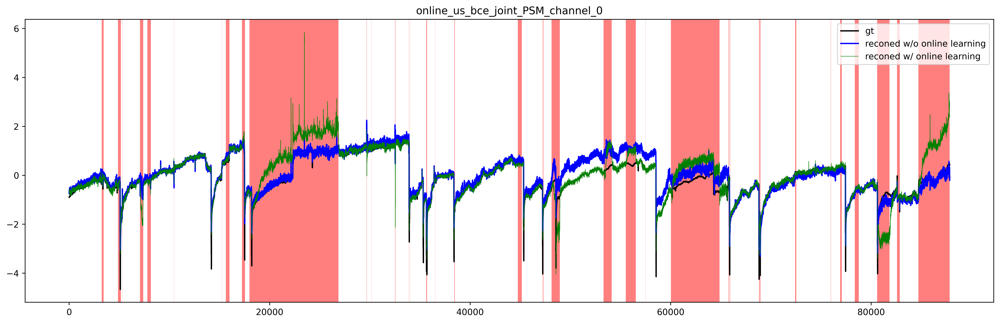

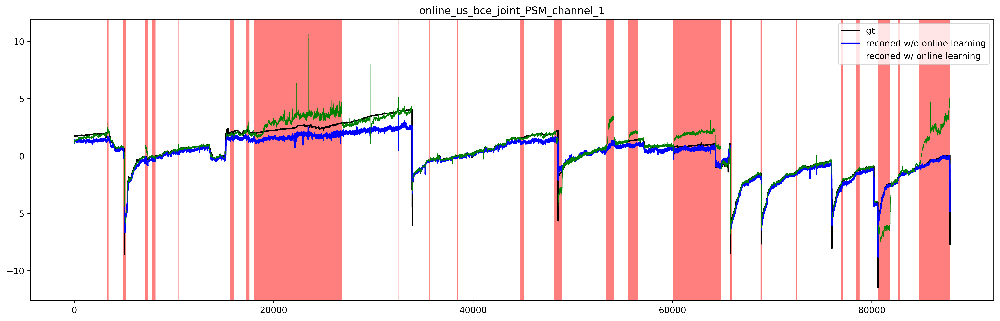

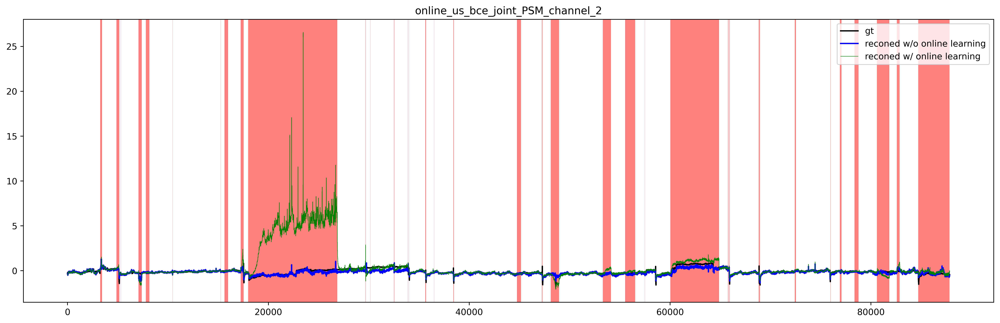

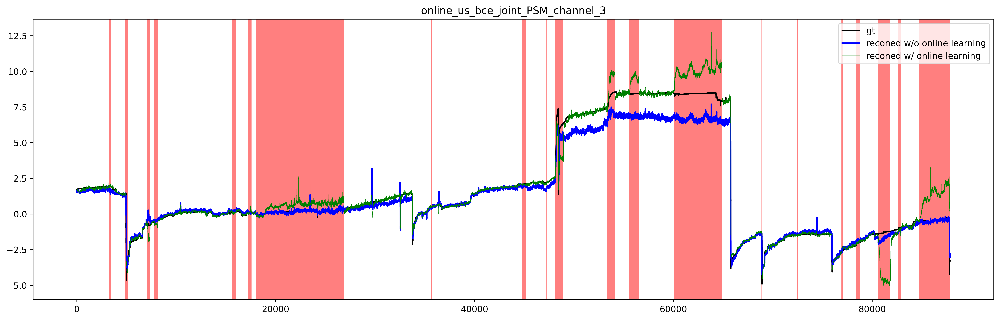

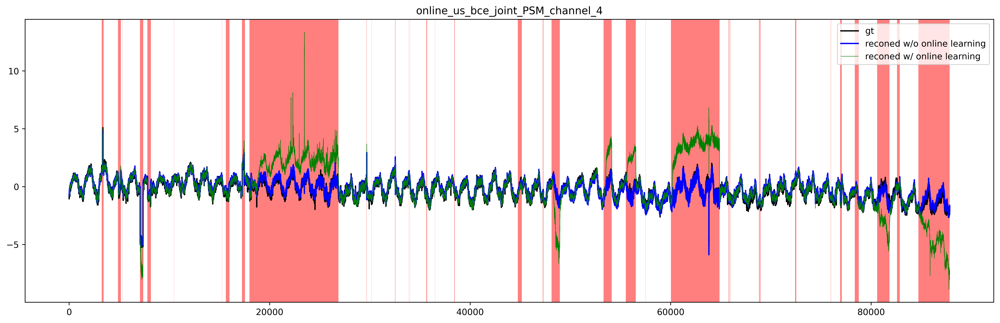

...

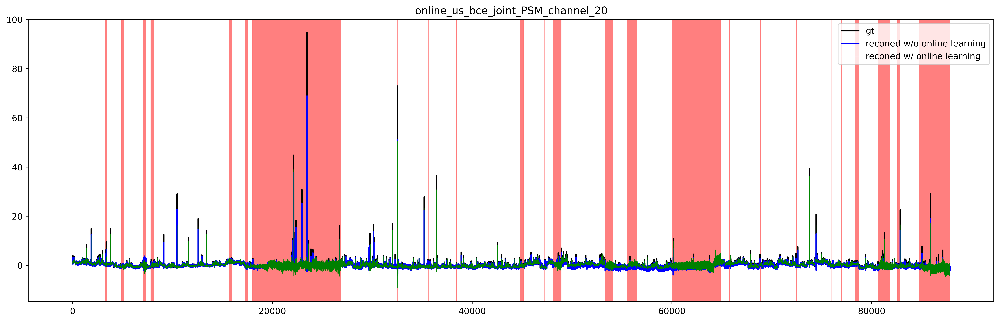

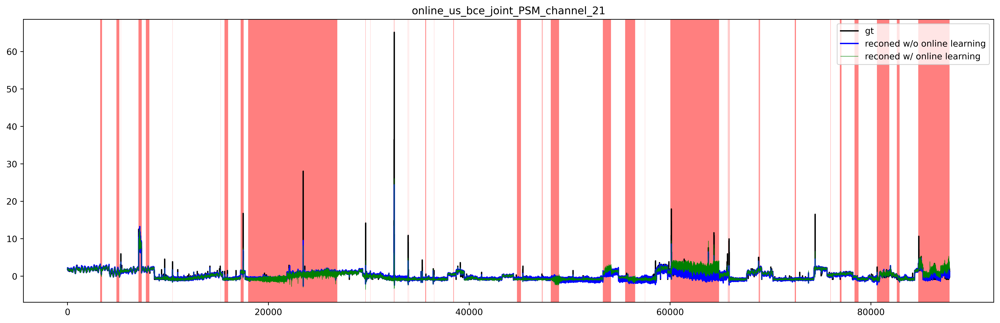

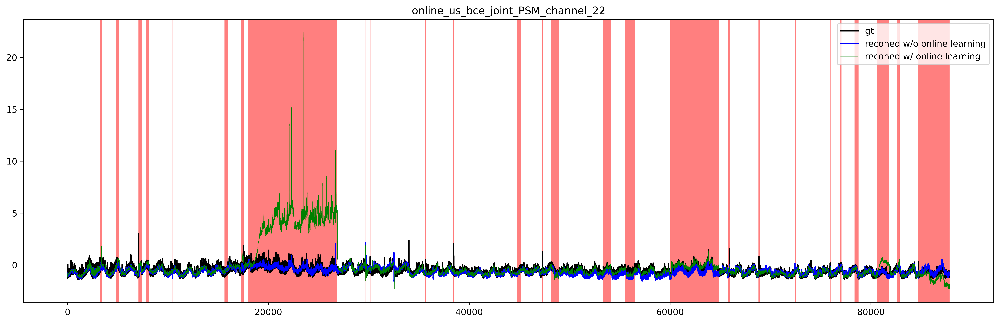

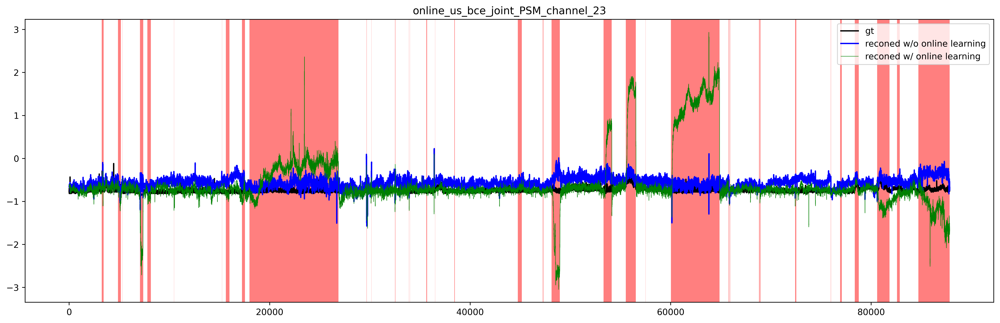

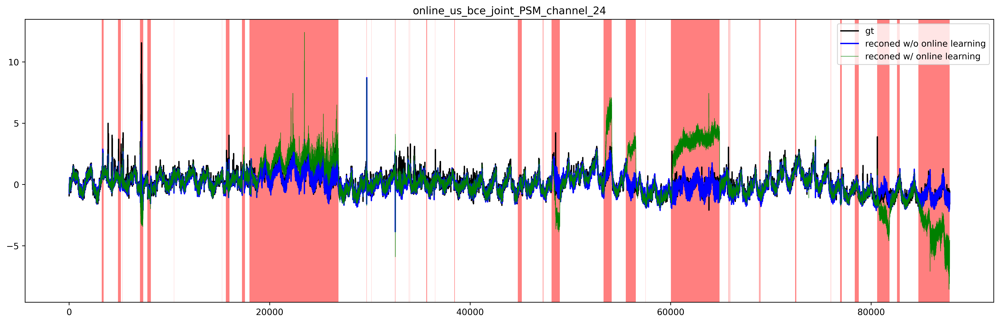

In [64]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(test_X[:, c], color="black", label="gt")
    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    plt.legend()
    plot_interval(plt, test_y)